## Image Processing Techniques
---
This notebook contains sample of below preprocessing techniques:
- Image Thresholding
- Image Filtering (Smoothing/Blurring)
- Reducing Noise
- Sharpness & Contrast handling
- Edge Detection
- Image Resizing
- Image Rotation
- Image Flipping
- Image Segmentation
- Image labelling
- Object detection

In [1]:
# Importing desired libraries
import cv2
import numpy as np
import matplotlib.pyplot as plt

#### Loading Image
Loading the image file onto which the above mentioned image processing should be carried out.

In [128]:
img = cv2.imread('./data_to_test/demo_image.jpg', cv2.IMREAD_COLOR)

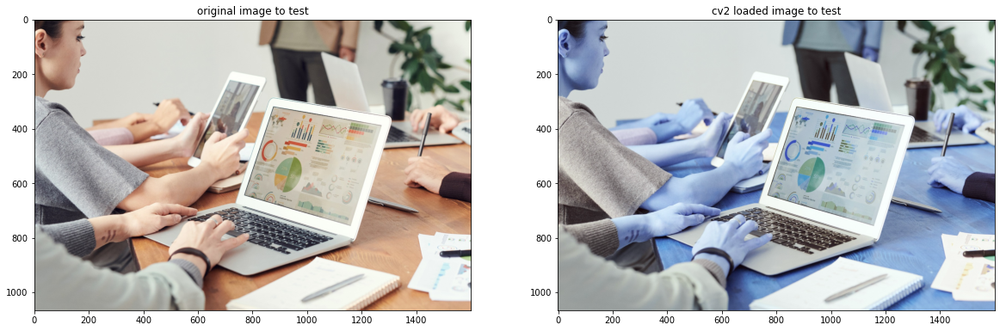

In [7]:
# converting cv2 BGR image to RGB image for matplotlib
img_RGB = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# to display the image loaded above
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 20))
ax[0].imshow(img_RGB)
ax[0].set_title('original image to test')
ax[1].imshow(img)
ax[1].set_title('cv2 loaded image to test')
plt.show()

### 1. Image Thresholding
---
- Image Thresholding is a technique to convert a grayscale image to a binary image.
- It is a type of image segmentation.
- It is used to separate an object from its background.
- It is also used to remove lighter or darker regions of an image.

##### Types of Thresholding:
1. Simple Thresholding -> It is used to separate an object from its background.
2. Adaptive Thresholding -> It is used to remove lighter or darker regions of an image. It is used when the image has different lighting conditions in different areas. It is of two types:
    - Gaussian Thresholding - threshold value is the weighted sum of neighbourhood values where weights are a gaussian window.
    - Mean Thresholding - threshold value is the mean of neighbourhood area.
        - blockSize: It is the size of the neighbourhood area.
        - C: It is a constant which is subtracted from the mean or weighted mean calculated.
3. Otsu's Thresholding -> It is used to find the optimal threshold value automatically. It automatically calculate threshold value of an image from its histogram.

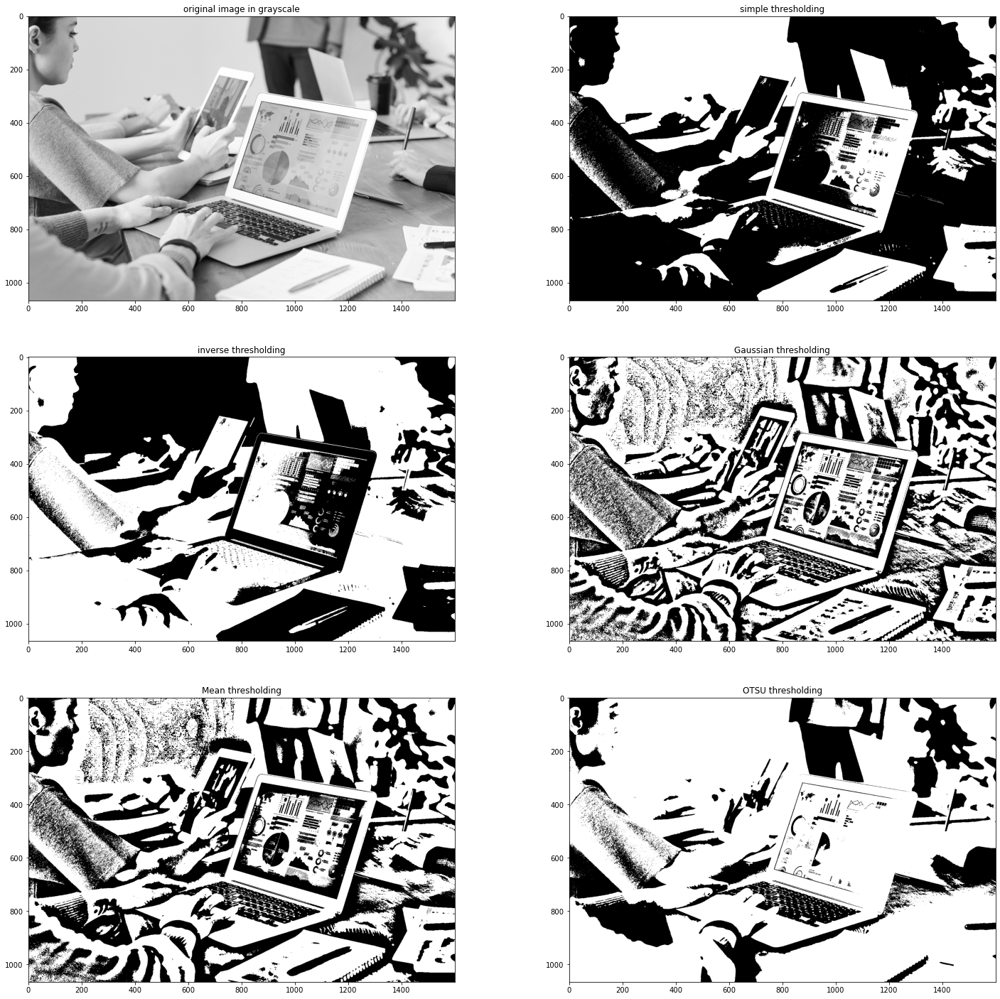

In [71]:
# converting the image to grayscale
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# applying simple thresholding
ret, thresh1 = cv2.threshold(img_gray, 197, 255, cv2.THRESH_BINARY)

# applying inverse thresholding
ret, thresh2 = cv2.threshold(img_gray, 197, 255, cv2.THRESH_BINARY_INV)

# # applying trunc thresholding
# ret, thresh3 = cv2.threshold(img_gray, 197, 255, cv2.THRESH_TRUNC)
#
# # applying tozero thresholding
# ret, thresh4 = cv2.threshold(img_gray, 197, 255, cv2.THRESH_TOZERO)
#
# # applying tozero inverse thresholding
# ret, thresh5 = cv2.threshold(img_gray, 197, 255, cv2.THRESH_TOZERO_INV)

# adaptive thresholding
gauss_thresh = cv2.adaptiveThreshold(src=img_gray, maxValue=255, adaptiveMethod=cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                     thresholdType=cv2.THRESH_BINARY, blockSize=91, C=1)

mean_thresh = cv2.adaptiveThreshold(src=img_gray, maxValue=255, adaptiveMethod=cv2.ADAPTIVE_THRESH_MEAN_C,
                                    thresholdType=cv2.THRESH_BINARY, blockSize=91, C=1)

# otsu's thresholding
ret, otsu_thresh = cv2.threshold(img_gray, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)

# to display the image loaded above
fig, ax = plt.subplots(nrows=3, ncols=2, figsize=(25, 25))

ax[0, 0].imshow(img_gray, cmap='gray')
ax[0, 0].set_title('original image in grayscale')

ax[0, 1].imshow(thresh1, cmap='gray')
ax[0, 1].set_title('simple thresholding')

ax[1, 0].imshow(thresh2, cmap='gray')
ax[1, 0].set_title('inverse thresholding')

ax[1, 1].imshow(gauss_thresh, cmap='gray')
ax[1, 1].set_title('Gaussian thresholding')

ax[2, 0].imshow(mean_thresh, cmap='gray')
ax[2, 0].set_title('Mean thresholding')

ax[2, 1].imshow(otsu_thresh, cmap='gray')
ax[2, 1].set_title('OTSU thresholding')

plt.show()

##### Observations:
- Gaussian thresholding is yields best results. As it makes the image elements more clear and visible. It shows the image parts hidden in the shadows and bright areas far more better than the other thresholding techniques.
- Mean thresholding is also good but not as good as Gaussian thresholding.
- Simple thresholding and inverse thresholding are not that good as they are not able to show the image parts hidden in the shadows and bright areas.

### 2. Image Filtering (Smoothing/Blurring)
---
- Image filtering is a technique to smoothen the image.
- It is used to remove noise from the image.

In [85]:
# method to convert image BGR to RGB
def convertToRGB(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

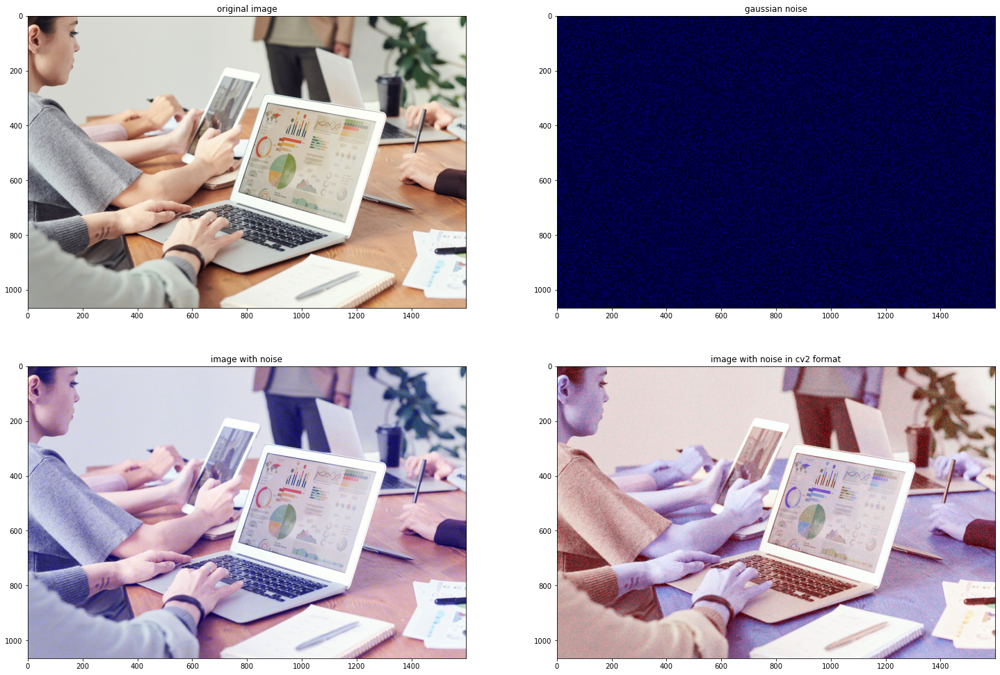

In [102]:
# adding gaussian noise to the image
gauss_noise = cv2.randn(np.zeros(img.shape, np.uint8), 0, 180)

# adding all the noise to the image
img_with_noise = cv2.add(img, gauss_noise)

# to display the image loaded above
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(25, 17))

ax[0, 0].imshow(convertToRGB(img))
ax[0, 0].set_title('original image')

ax[0, 1].imshow(convertToRGB(gauss_noise))
ax[0, 1].set_title('gaussian noise')

ax[1, 0].imshow(convertToRGB(img_with_noise))
ax[1, 0].set_title('image with noise')

ax[1, 1].imshow(img_with_noise)
ax[1, 1].set_title('image with noise in cv2 format')

plt.show()

The image which we initially took doesn't have any noise in it. But after adding the gaussian noise to it, we can see that the image is not clear and it is not easy to identify the image elements.
So, we need to apply some filtering techniques to remove the noise from the image.

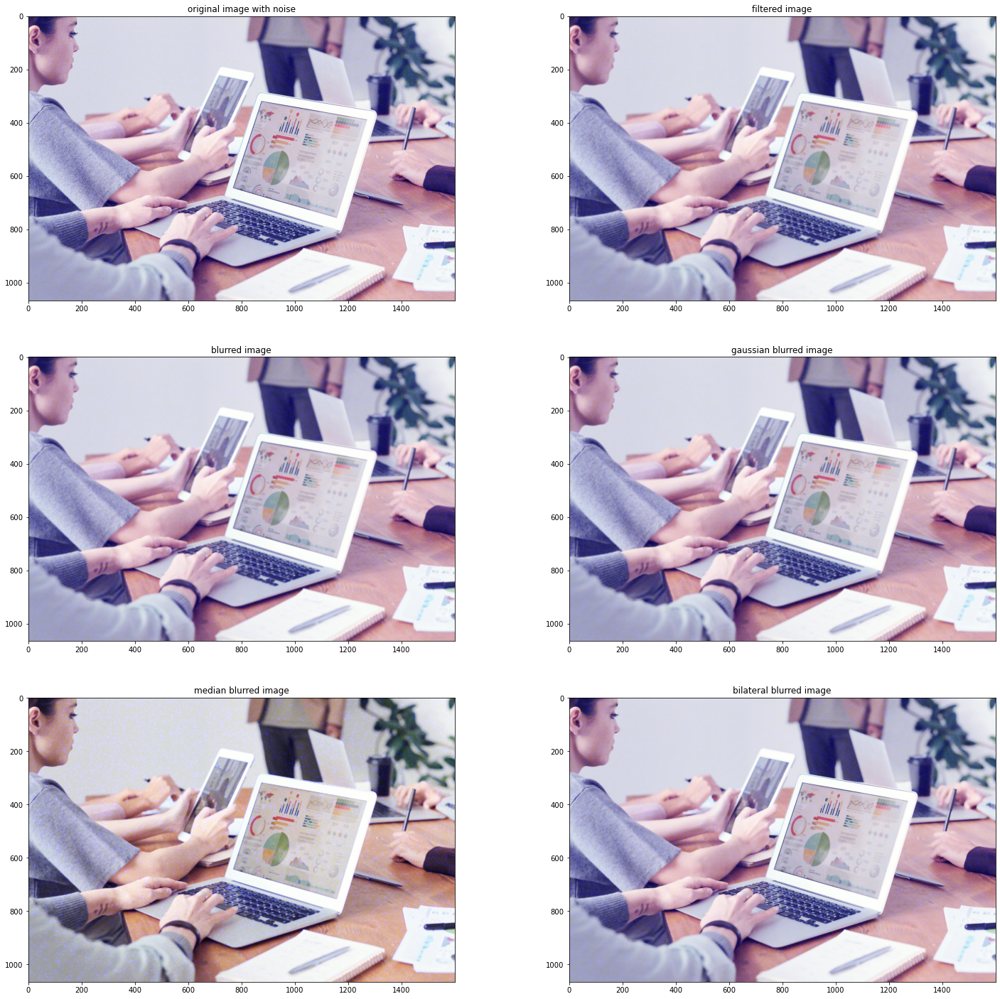

In [107]:
# a random and most basic kernel for filtering
kernel = np.ones((5, 5), np.float32)/25

# applying filtering (smoothing) to the image
img_filtered = cv2.filter2D(src=img_with_noise, ddepth=-1, kernel=kernel)

# applying blurring to the image
img_blurred = cv2.blur(src=img_with_noise, ksize=(5, 5))

# applying gaussian blurring to the image
img_gaussian_blurred = cv2.GaussianBlur(src=img_with_noise, ksize=(5, 5), sigmaX=180)

# applying median blurring to the image
img_median_blurred = cv2.medianBlur(src=img_with_noise, ksize=5)

# applying bilateral blurring to the image
img_bilateral_blurred = cv2.bilateralFilter(src=img_with_noise, d=9, sigmaColor=75, sigmaSpace=75)

# to display the image loaded above
fig, ax = plt.subplots(nrows=3, ncols=2, figsize=(25, 25))

ax[0, 0].imshow(convertToRGB(img_with_noise))
ax[0, 0].set_title('original image with noise')

ax[0, 1].imshow(convertToRGB(img_filtered))
ax[0, 1].set_title('filtered(smoothing) image')

ax[1, 0].imshow(convertToRGB(img_blurred))
ax[1, 0].set_title('blurred image')

ax[1, 1].imshow(convertToRGB(img_gaussian_blurred))
ax[1, 1].set_title('gaussian blurred image')

ax[2, 0].imshow(convertToRGB(img_median_blurred))
ax[2, 0].set_title('median blurred image')

ax[2, 1].imshow(convertToRGB(img_bilateral_blurred))
ax[2, 1].set_title('bilateral blurred image')

plt.show()

##### Observations:
- Median blurring gives us the result which is closest to the original image without noise.
- Gaussian blurring is also good but not as good as median blurring. It smoothes the noises but not upto the mark.
- Smoothing and basic blurring gives ok ok results.
- Bilateral blurring is not very good as it is not able to remove much of the noise from the image.

Median blurring doesn't remove the noise completely so there are few more noise rmoving techniques which we can apply to the image we will see them below after the next part.

##### Performing some blurring techniques on the the best thresholded image above
Applying median blurring and Gaussian blurring on the best thresholded image obtained above.

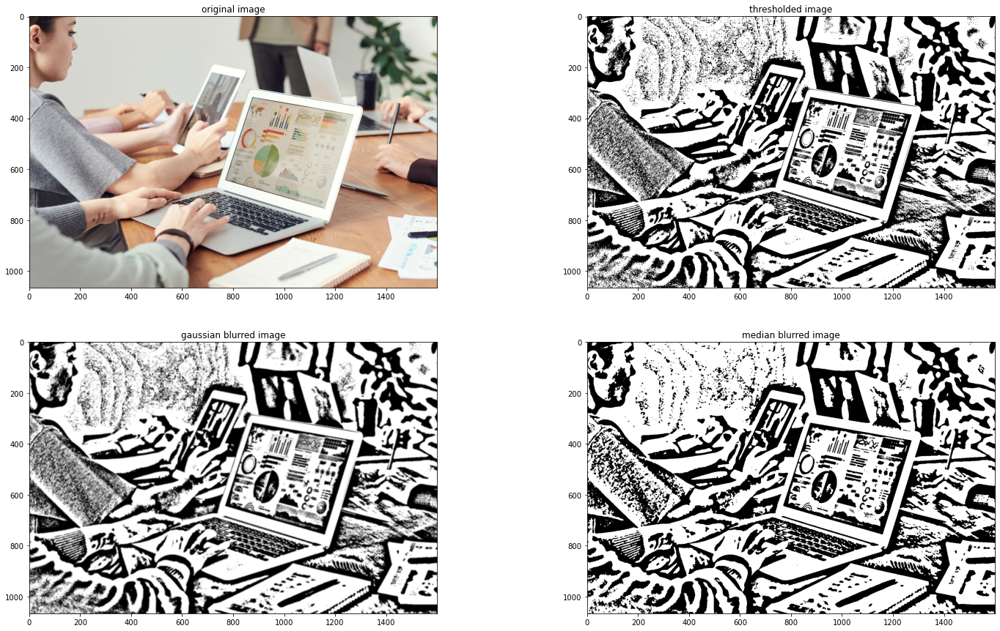

In [110]:
# applying Gaussian blurring to the image
img_gaussian_blurred = cv2.GaussianBlur(src=gauss_thresh, ksize=(5, 5), sigmaX=180, sigmaY=180)

# applying median blurring to the image
img_median_blurred = cv2.medianBlur(src=gauss_thresh, ksize=5)

# to display the image loaded above
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(25, 15))

ax[0, 0].imshow(convertToRGB(img))
ax[0,0].set_title('original image')

ax[0, 1].imshow(gauss_thresh, cmap='gray')
ax[0, 1].set_title('thresholded image')

ax[1, 0].imshow(img_gaussian_blurred, cmap='gray')
ax[1, 0].set_title('gaussian blurred image')

ax[1, 1].imshow(img_median_blurred, cmap='gray')
ax[1, 1].set_title('median blurred image')

plt.show()

##### Observations:
As we can see above, median blurring able to remove a little bit of more noise from the thresholded image.

### 3. Removing Noises
---
#### 3.1. Morphological Transformations
Morphological transformations are some simple operations based on the image shape. It is normally performed on binary images. It needs two inputs, one is our original image, second one is called structuring element or kernel which decides the nature of operation. Two basic morphological operators are Erosion and Dilation. Then its variant forms like Opening, Closing, Gradient etc also comes into play.

#### 3.1.1. Erosion
The basic idea of erosion is just like soil erosion only, it erodes away the boundaries of foreground object (Always try to keep foreground in white). So what it does? The kernel slides through the image (as in 2D convolution). A pixel in the original image (either 1 or 0) will be considered 1 only if all the pixels under the kernel is 1, otherwise it is eroded (made to zero).

#### 3.1.2. Dilation
It is just opposite of erosion. Here, a pixel element is '1' if atleast one pixel under the kernel is '1'. So it increases the white region in the image or size of foreground object increases. Normally, in cases like noise removal, erosion is followed by dilation. Because, erosion removes white noises, but it also shrinks our object. So we dilate it. Since noise is gone, they won't come back, but our object area increases. It is also useful in joining broken parts of an object.

#### 3.1.3. Opening
Opening is just another name of erosion followed by dilation. Here we use the function, cv2.morphologyEx()

#### 3.1.4. Closing
Closing is reverse of Opening, Dilation followed by Erosion. It is useful in closing small holes inside the foreground objects, or small black points on the object.

#### 3.1.5. Morphological Gradient
It is the difference between dilation and erosion of an image.

#### 3.1.6. Top Hat
It is the difference between input image and Opening of the image. It is used to enhance bright objects of interest in a dark background.

#### 3.1.7. Black Hat
It is the difference between the closing of the input image and input image. It is used to enhance dark objects of interest in a bright background.

#### 3.1.8. Image Denoising
OpenCV provides four variations of this technique.
- Non-Local Means Denoising Algorithm: We use function -> cv2.fastNlMeansDenoising().
- Gaussian Filtering: We use cv2.GaussianBlur() function.
- Median Filtering: We use cv2.medianBlur() function.
- Bilateral Filtering: We use cv2.bilateralFilter() function.


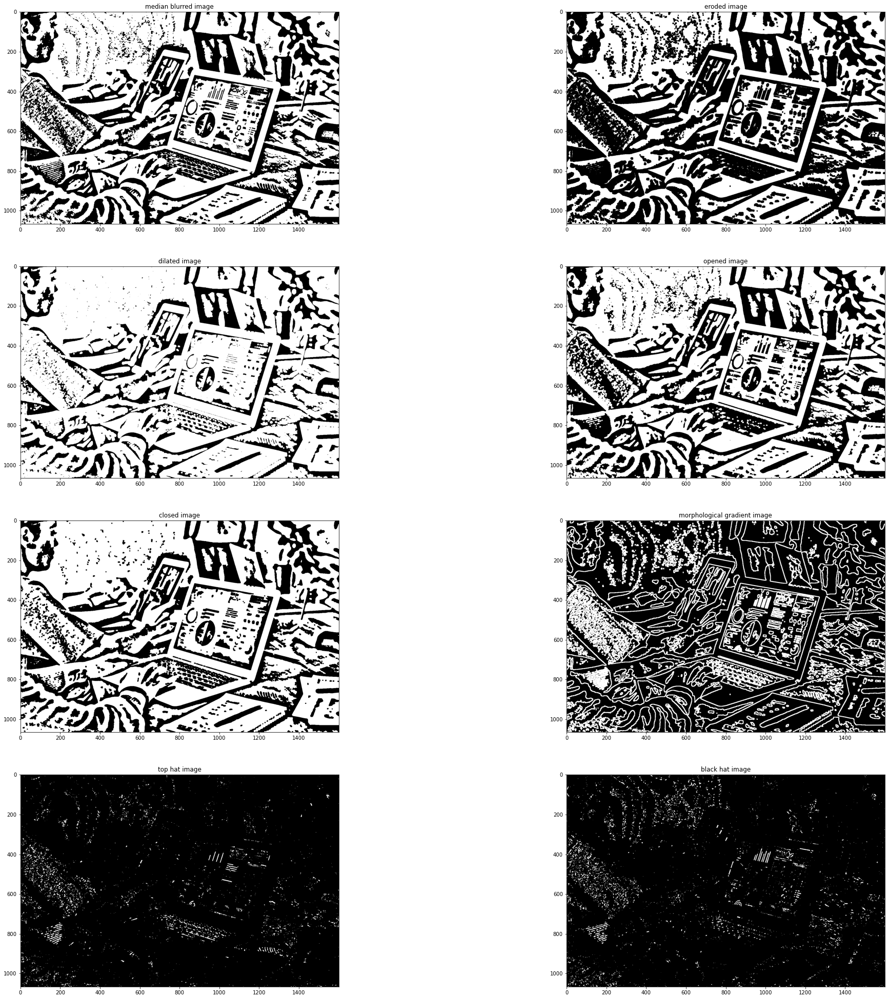

In [121]:
# kernal for morphological transformations
kernel = np.ones((5, 5), np.uint8)

# applying erosion to the image
img_erosion = cv2.erode(src=img_median_blurred, kernel=kernel, iterations=1)

# applying dilation to the image
img_dilation = cv2.dilate(src=img_median_blurred, kernel=kernel, iterations=1)

# applying opening to the image
img_opening = cv2.morphologyEx(src=img_median_blurred, op=cv2.MORPH_OPEN, kernel=kernel)

# applying closing to the image
img_closing = cv2.morphologyEx(src=img_median_blurred, op=cv2.MORPH_CLOSE, kernel=kernel)

# applying morphological gradient to the image
img_morphological_gradient = cv2.morphologyEx(src=img_median_blurred, op=cv2.MORPH_GRADIENT, kernel=kernel)

# applying top hat to the image
img_top_hat = cv2.morphologyEx(src=img_median_blurred, op=cv2.MORPH_TOPHAT, kernel=kernel)

# applying black hat to the image
img_black_hat = cv2.morphologyEx(src=img_median_blurred, op=cv2.MORPH_BLACKHAT, kernel=kernel)

# to display the image loaded above
fig, ax = plt.subplots(nrows=4, ncols=2, figsize=(35, 35))

ax[0, 0].imshow(img_median_blurred, cmap='gray')
ax[0, 0].set_title('median blurred image')

ax[0, 1].imshow(img_erosion, cmap='gray')
ax[0, 1].set_title('eroded image')

ax[1, 0].imshow(img_dilation, cmap='gray')
ax[1, 0].set_title('dilated image')

ax[1, 1].imshow(img_opening, cmap='gray')
ax[1, 1].set_title('opened image')

ax[2, 0].imshow(img_closing, cmap='gray')
ax[2, 0].set_title('closed image')

ax[2, 1].imshow(img_morphological_gradient, cmap='gray')
ax[2, 1].set_title('morphological gradient image')

ax[3, 0].imshow(img_top_hat, cmap='gray')
ax[3, 0].set_title('top hat image')

ax[3, 1].imshow(img_black_hat, cmap='gray')
ax[3, 1].set_title('black hat image')

plt.show()

##### Observations:
- In the above code, we have applied different morphological transformations to the image.
- We found that closing technique removes the noise from the image quite well in our usecase and help us to identify objects outlines and human's presence in the image quite well.
- In our usecase, dilation is best for removal of background noise completely and give some image to work with.
- Erosion will be best if we want to focus on the elements present in the laptop screen in that image.
- Opening gives a more refined version of erosion.
- Morphological gradient gives the outline of most the objects present in the image.
- Top hat and black hat are not that useful for our given test image.

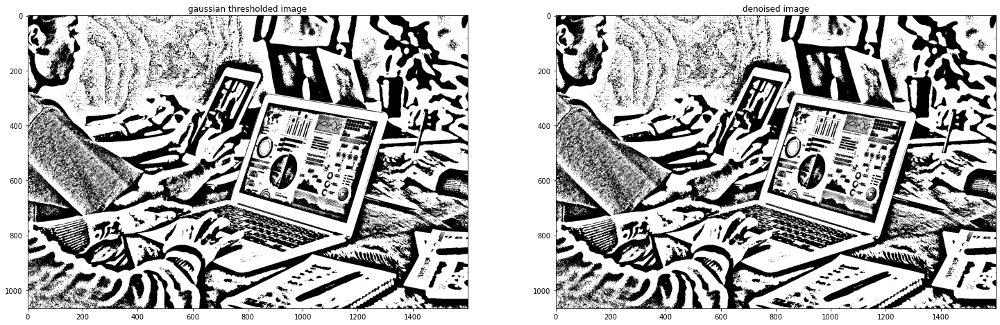

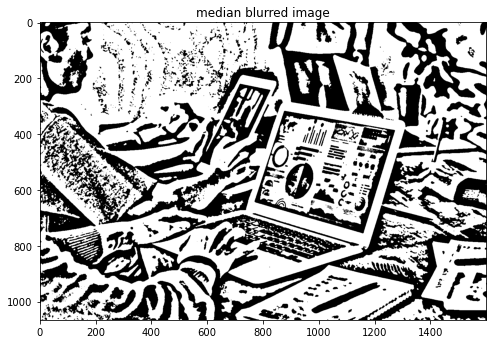

In [118]:
# non-local means denoising algorithm
img_denoised = cv2.fastNlMeansDenoising(src=gauss_thresh, h=10, templateWindowSize=7, searchWindowSize=21)
# h -> parameter deciding filter strength. Higher h value removes noise better, but removes details of image also. (10 is ok)
# templateWindowSize -> should be odd. (recommended 7)
# searchWindowSize -> should be odd. (recommended 21)

# to display the image loaded above
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(25, 25))

ax[0].imshow(gauss_thresh, cmap='gray')
ax[0].set_title('gaussian thresholded image')

ax[1].imshow(img_denoised, cmap='gray')
ax[1].set_title('denoised image')

plt.show()

plt.figure(figsize=(8, 8))
plt.imshow(img_median_blurred, cmap='gray')
plt.title('median blurred image')
plt.show()

##### Observations:
- Here, we see that median blurring still removes the noise better than non-local means denoising algorithm for our usecase.

### 3.2. Image Gradients
OpenCV provides three types of gradient filters or High-pass filters,that is, Sobel, Scharr and Laplacian. We will see each one of them.
- Sobel Derivative
- Scharr Derivative
- Laplacian Derivative




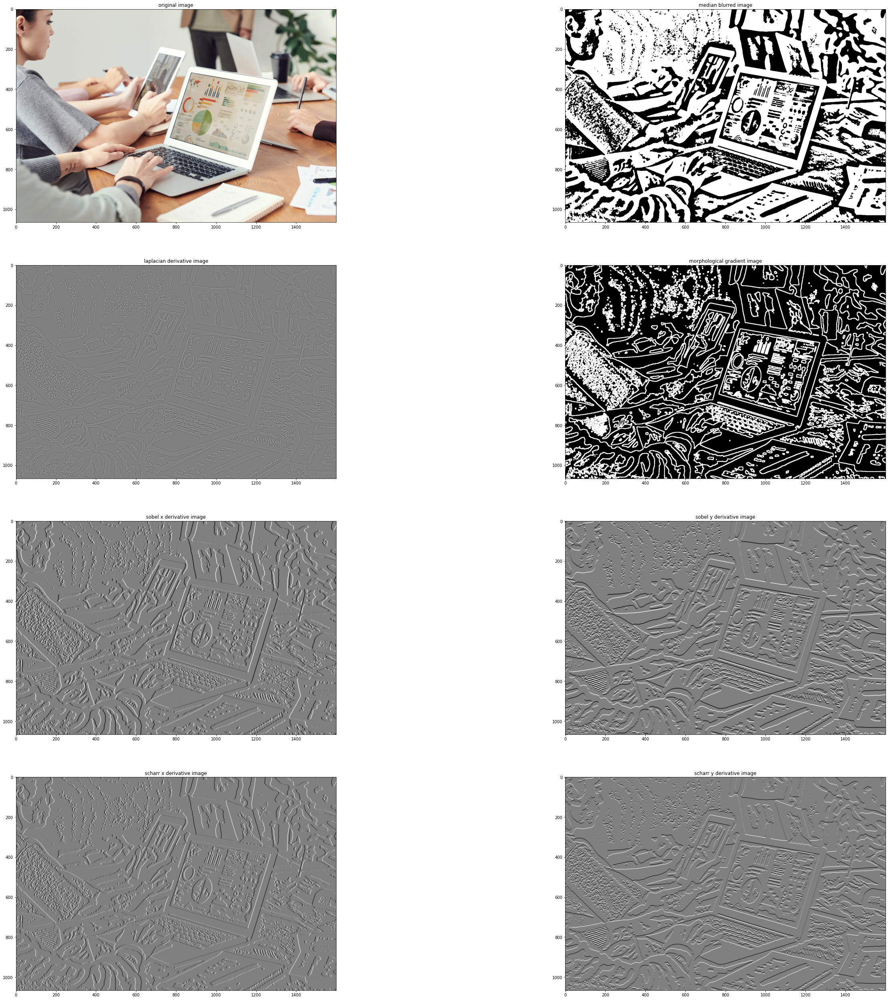

In [123]:
# applying Laplacian derivative to the image
img_laplacian = cv2.Laplacian(src=img_median_blurred, ddepth=cv2.CV_64F, ksize=5)

# applying Sobel derivative to the image
img_sobelx = cv2.Sobel(src=img_median_blurred, ddepth=cv2.CV_64F, dx=1, dy=0, ksize=5)
img_sobely = cv2.Sobel(src=img_median_blurred, ddepth=cv2.CV_64F, dx=0, dy=1, ksize=5)

# applying Scharr derivative to the image
img_scharrx = cv2.Scharr(src=img_median_blurred, ddepth=cv2.CV_64F, dx=1, dy=0)
img_scharry = cv2.Scharr(src=img_median_blurred, ddepth=cv2.CV_64F, dx=0, dy=1)

# applying morphological gradient to the image
img_morphological_gradient = cv2.morphologyEx(src=img_median_blurred, op=cv2.MORPH_GRADIENT, kernel=kernel)

# to display the image loaded above
fig, ax = plt.subplots(nrows=4, ncols=2, figsize=(45, 45))

ax[0, 0].imshow(convertToRGB(img))
ax[0, 0].set_title('original image')

ax[0, 1].imshow(img_median_blurred, cmap='gray')
ax[0, 1].set_title('median blurred image')

ax[1, 0].imshow(img_laplacian, cmap='gray')
ax[1, 0].set_title('laplacian derivative image')

ax[1, 1].imshow(img_morphological_gradient, cmap='gray')
ax[1, 1].set_title('morphological gradient image')

ax[2, 0].imshow(img_sobelx, cmap='gray')
ax[2, 0].set_title('sobel x derivative image')

ax[2, 1].imshow(img_sobely, cmap='gray')
ax[2, 1].set_title('sobel y derivative image')

ax[3, 0].imshow(img_scharrx, cmap='gray')
ax[3, 0].set_title('scharr x derivative image')

ax[3, 1].imshow(img_scharry, cmap='gray')
ax[3, 1].set_title('scharr y derivative image')

plt.show()

##### Observations:
- All the above techniques are used to find the edges in the image.
- For our usecase, we found that Sobel derivative and Morphological Gradient gives the best result.

### 4. Edge Detection
---
Edge detection is an image processing technique for finding the boundaries of objects within images. It works by detecting discontinuities in brightness. Edge detection is used for image segmentation and data extraction in areas such as image processing, computer vision, and machine vision.

#### 4.1. Canny Edge Detection
Canny Edge Detection is a popular edge detection algorithm. It was developed by John F. Canny in 1986. It is a multi-stage algorithm and we will go through each stages.

#### 4.2. Edge Detection using Contours
Contours are defined as the line joining all the points along the boundary of an image that are having the same intensity. Contours come handy in shape analysis, finding the size of the object of interest, and object detection.

#### 4.3. Edge Detection using Corner Detection
Corner Detection is an approach used within computer vision systems to extract certain kinds of features and infer the contents of an image. Corner detection is frequently used in motion detection, image registration, video tracking, image mosaicing, panorama stitching, 3D modelling, and object recognition.

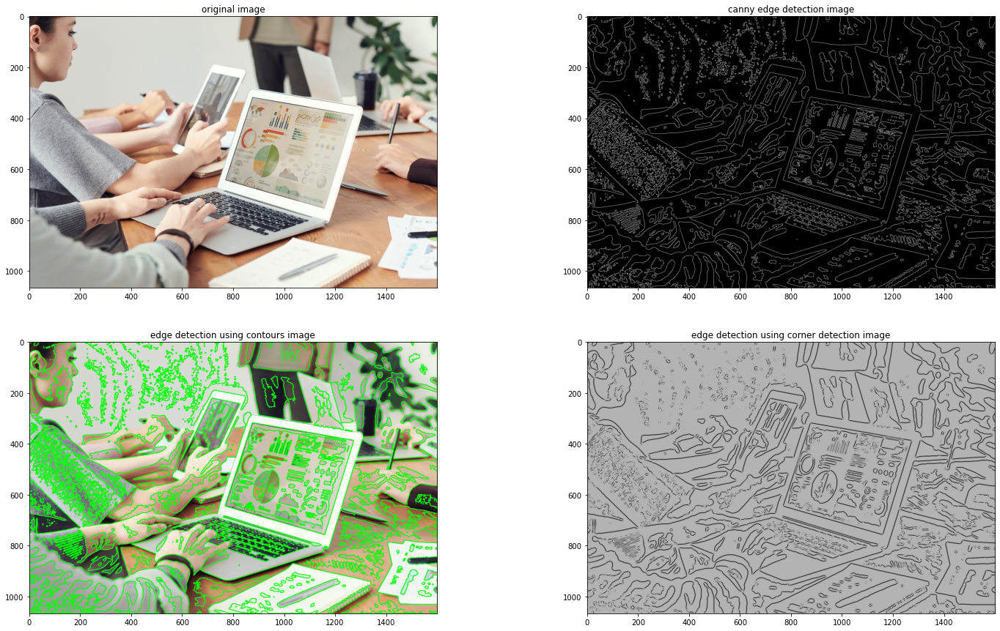

In [147]:
# applying canny edge detection to the image
img_canny = cv2.Canny(image=img_median_blurred, threshold1=100, threshold2=200)

# applying edge detection using contours to the image
contours, hierarchy = cv2.findContours(image=img_median_blurred, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_SIMPLE)
img_contours = cv2.drawContours(image=img.copy(), contours=contours, contourIdx=-1, color=(0, 255, 0), thickness=2)
# mode: Contour retrieval mode  cv2.RETR_TREE -> retrieves all the contours and creates a full family hierarchy list.
# method: Contour approximation method
# cv2.CHAIN_APPROX_SIMPLE -> It removes all redundant points and compresses the contour, thereby saving memory.
# contourIdx: Parameter indicating a contour to draw. If it is negative, all the contours are drawn.
# contours: All the input contours. Each contour is stored as a point vector.

# applying edge detection using corner detection to the image
img_corner = cv2.cornerHarris(src=img_median_blurred, blockSize=2, ksize=15, k=0.04)
# ksize: Aperture parameter of the Sobel derivative used.
# blockSize: It is the size of neighbourhood considered for corner detection
# k: Harris detector free parameter in the equation.

# to display the image loaded above
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(25, 15))

ax[0, 0].imshow(convertToRGB(img))
ax[0, 0].set_title('original image')

ax[0, 1].imshow(img_canny, cmap='gray')
ax[0, 1].set_title('canny edge detection image')

ax[1, 0].imshow(convertToRGB(img_contours))
ax[1, 0].set_title('edge detection using contours image')

ax[1, 1].imshow(img_corner, cmap='gray')
ax[1, 1].set_title('edge detection using corner detection image')

plt.show()

##### Observations:
- All the above techniques are used to find the edges in the image.
- All are giving decent results but are prone to noise.

### 5. Image Sharpening and Contrast Handling
---
- Image sharpening is a powerful tool for emphasizing texture and drawing viewer focus. It's also useful for making text-heavy slides easier to read.
- Sharpening is the process of enhancing the edges and fine details in an image to make it appear sharper and more defined. It is important because it can help to bring out the details and features in an image, making it more visually appealing and easier to understand. Sharpening can be used to correct blur or softness in an image and can be applied using a variety of techniques.
- Contrast is the difference in luminance or colour that makes an object (or its representation in an image or display) distinguishable. In visual perception of the real world, contrast is determined by the difference in the colour and brightness of the object and other objects within the same field of view.
- Contrast can also help to correct defects or flaws in the image and make it easier to see details. Finding the right balance of brightness and contrast is important for creating an attractive and effective image. Contrast is scaling of each pixel value and brightness is shifting(adding a scalar value to) of each pixel value.

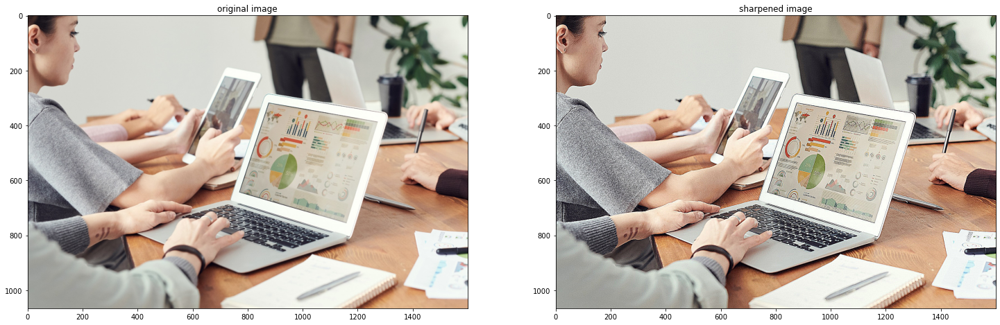

In [152]:
# kernel for sharpening the image
kernel_sharpening = np.array([[-1, -1, -1],
                              [-1, 9, -1],
                              [-1, -1, -1]])

# applying image sharpening to the image
img_sharpened = cv2.filter2D(src=img, ddepth=-1, kernel=kernel_sharpening)

# to display the image loaded above
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(25, 25))

ax[0].imshow(convertToRGB(img))
ax[0].set_title('original image')

ax[1].imshow(convertToRGB(img_sharpened))
ax[1].set_title('sharpened image')

plt.show()

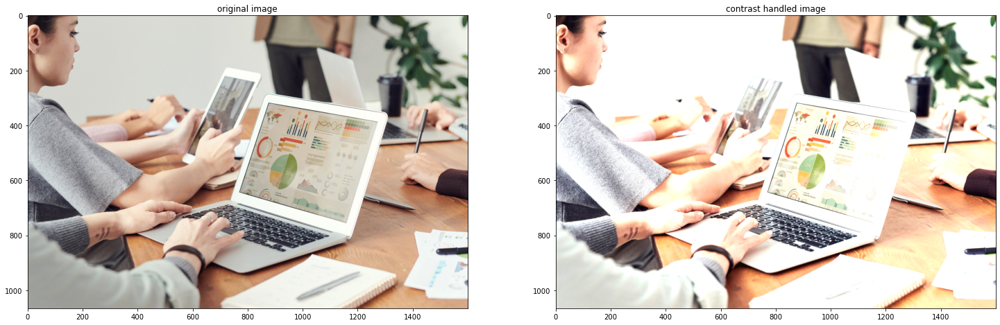

In [155]:
# applying contrast handling to the image
alpha = 1.5  # Control contrast by 1.5
beta = -20  # Control brightness by 0
img_contrast = cv2.convertScaleAbs(src=img, alpha=alpha, beta=beta)

# to display the image loaded above
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(25, 15))

ax[0].imshow(convertToRGB(img))
ax[0].set_title('original image')

ax[1].imshow(convertToRGB(img_contrast))
ax[1].set_title('contrast handled image')

plt.show()

##### Observations:
- Image sharpening and contrast handling are used to enhance the image.
- Image sharpening is done using a kernel.
- Contrast handling is done using alpha and beta values.
- Both gives an enchanced version of the image.
- These techniques should be done before image thresholding only

### 6. Image Resizing and Cropping
---
- Image resizing refers to scaling of images. Scaling comes handy in many image processing as well as machine learning applications. It helps in reducing the number of pixels from an image and that has several advantages e.g. It can reduce the time of training of a neural network as more is the number of pixels in an image more is the number of input nodes which in turn increases the complexity of the model.
- Image cropping is a technique of extracting a portion of an image. It is also called image clipping. It is used to remove unwanted portions of an image or to focus on a particular region of an image.

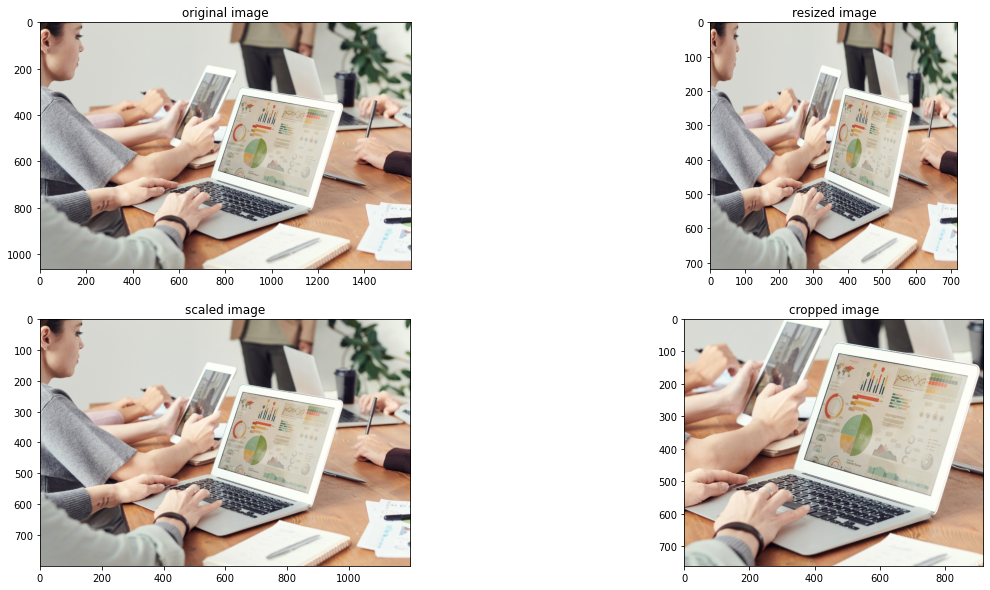

In [164]:
# resizing the image
img_resized = cv2.resize(src=img.copy(), dsize=(720, 720), interpolation=cv2.INTER_LINEAR)
# dsize: output image size
# interpolation: interpolation method -> INTER_LINEAR -> bilinear interpolation (used by default) -> INTER_AREA -> resampling using pixel area relation -> INTER_CUBIC -> bicubic interpolation over 4x4 pixel neighborhood -> INTER_LANCZOS4 -> Lanczos interpolation over 8x8 pixel neighborhood  -> INTER_NEAREST -> nearest neighbor interpolation  -> INTER_LINEAR_EXACT -> Bit exact bilinear interpolation   -> INTER_MAX -> mask for interpolation codes.

# image scaling
img_scaled = cv2.resize(src=img.copy(), dsize=None, fx=0.75, fy=0.75, interpolation=cv2.INTER_LINEAR)
# fx: scale factor along the horizontal axis
# fy: scale factor along the vertical axis

# cropping the image
new_ref_img = img.copy()
img_cropped = new_ref_img[210:970, 400:1320]    # [y1:y2, x1:x2]

# Save the cropped image
cv2.imwrite('data_to_test/object_in_image.jpg', img_cropped)

# to display the image loaded above
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(20, 10))

ax[0,0].imshow(convertToRGB(img))
ax[0,0].set_title('original image')

ax[0,1].imshow(convertToRGB(img_resized))
ax[0,1].set_title('resized image')

ax[1,0].imshow(convertToRGB(img_scaled))
ax[1,0].set_title('scaled image')

ax[1,1].imshow(convertToRGB(img_cropped))
ax[1,1].set_title('cropped image')

plt.show()

### 7. Image Rotation and Translation
---
- Image rotation is a common image processing routine with applications in matching, alignment, and other image-based algorithms. It is also a common geometric operation to apply to images before other types of processing. Image rotation is a form of image transformation in which an image is rotated by a certain number of degrees.
- Image translation is a form of image transformation in which an image is translated by a certain number of pixels in a certain direction.

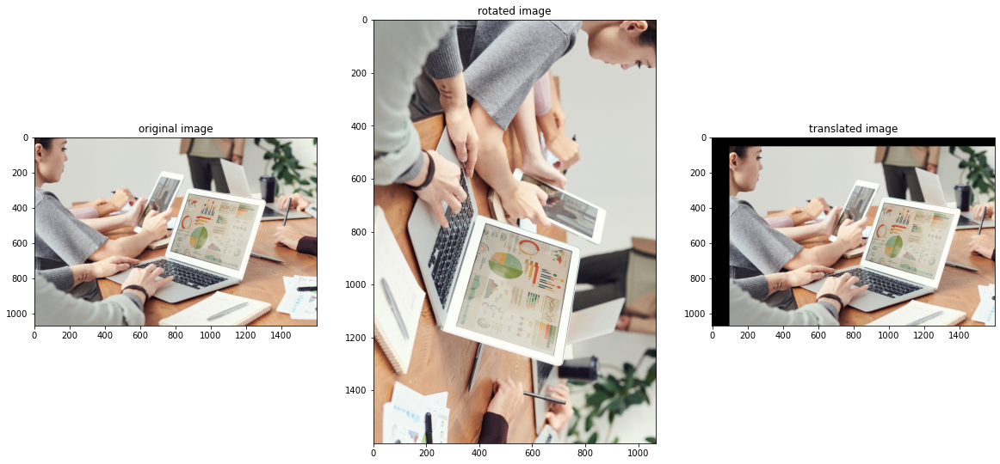

In [161]:
# rotation of the image
img_rotated = cv2.rotate(src=img.copy(), rotateCode=cv2.ROTATE_90_CLOCKWISE)
# rotateCode: flag specifying how to rotate the array; ROTATE_90_CLOCKWISE -> rotate 90 degrees clockwise; ROTATE_180 -> rotate 180 degrees clockwise; ROTATE_90_COUNTERCLOCKWISE -> rotate 270 degrees clockwise

# translation of the image
img_translated = cv2.warpAffine(src=img.copy(), M=np.float32([[1, 0, 100], [0, 1, 50]]), dsize=(img.shape[1], img.shape[0]))
# M: transformation matrix; dsize: size of the output image
# translation matrix: [[1, 0, tx], [0, 1, ty]] -> tx: translation along the x-axis; ty: translation along the y-axis

# to display the image loaded above
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(20, 10))

ax[0].imshow(convertToRGB(img))
ax[0].set_title('original image')

ax[1].imshow(convertToRGB(img_rotated))
ax[1].set_title('rotated image')

ax[2].imshow(convertToRGB(img_translated))
ax[2].set_title('translated image')

plt.show()

### 8. Image Flipping
---
- Image flipping is a form of image transformation in which an image is flipped or mirrored across an axis.
- Image flipping is used to reverse the orientation of an image.

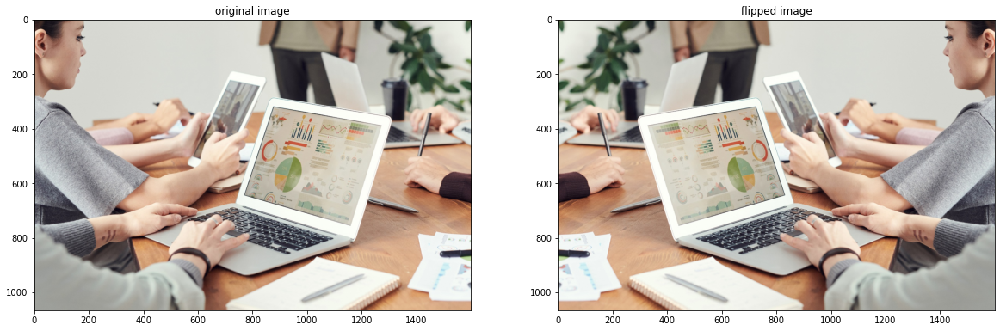

In [162]:
# flipping the image
img_flipped = cv2.flip(src=img.copy(), flipCode=1)
# flipCode: a flag to specify how to flip the array; 0 -> flip vertically; 1 -> flip horizontally; -1 -> flip both vertically and horizontally

# to display the image loaded above
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 10))

ax[0].imshow(convertToRGB(img))
ax[0].set_title('original image')

ax[1].imshow(convertToRGB(img_flipped))
ax[1].set_title('flipped image')

plt.show()

### Extra: Template Matching
---
- Template matching is a technique for finding areas of an image that match (are similar) to a template image (patch)..
- A patch is a small image with certain features.

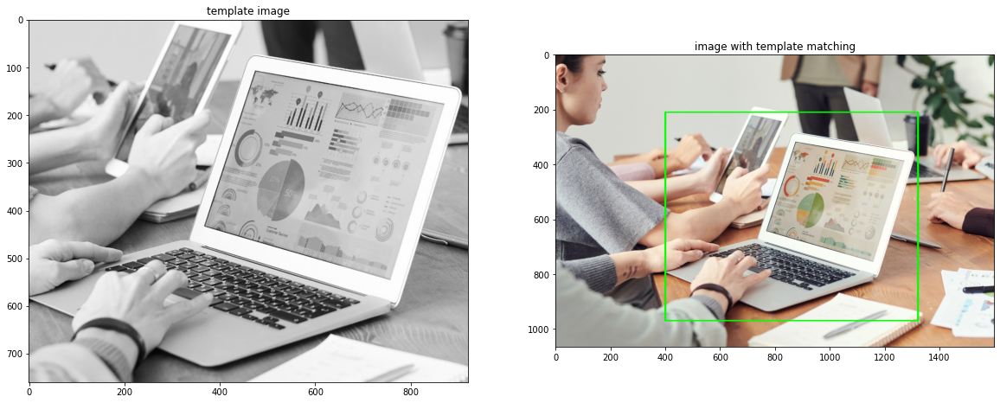

In [183]:
# template matching
# original image
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_copy = img.copy()

# # rotated image
# img_gray = cv2.cvtColor(img_rotated, cv2.COLOR_BGR2GRAY)
# img_copy = img_rotated.copy()

# # flipped image
# img_gray = cv2.cvtColor(img_flipped, cv2.COLOR_BGR2GRAY)
# img_copy = img_flipped.copy()

# # resized image                                                     # able to detect for very low threshold (0.125)
# img_gray = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
# img_copy = img_resized.copy()

# # scaled image                                                    # able to detect for very low threshold (0.25)
# img_gray = cv2.cvtColor(img_scaled, cv2.COLOR_BGR2GRAY)
# img_copy = img_scaled.copy()

# # translated image                            # able to detect properly if the object visible in translated image
# img_gray = cv2.cvtColor(img_translated, cv2.COLOR_BGR2GRAY)
# img_copy = img_translated.copy()

template = cv2.imread('data_to_test/object_in_image.jpg', 0)
w, h = template.shape[::-1]

res = cv2.matchTemplate(image=img_gray, templ=template, method=cv2.TM_CCOEFF_NORMED)
# TM_CCOEFF_NORMED: correlation coefficient
threshold = 0.95
loc = np.where(res >= threshold)

for pt in zip(*loc[::-1]):
    cv2.rectangle(img_copy, pt, (pt[0]+w, pt[1]+h), (0, 255, 0), 2)

# to display the image loaded above
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 10))

ax[0].imshow(convertToRGB(template))
ax[0].set_title('template image')

ax[1].imshow(convertToRGB(img_copy))
ax[1].set_title('image with template matching')

plt.show()

##### Observation:
- The template matching algorithm is able to detect the object in the image.
- It is not able to detect the object in the image when the object is rotated or flipped.
- It is able to detect the object in the image when the object is resized or scaled but the threshold value needs to be very low.
- It is able to detect the object in the image when the object is translated considering the object is visible in the translated image.

### 9. Image Segmentation
---
- Image segmentation is the process of partitioning an image into multiple segments.
- The goal of segmentation is to simplify and/or change the representation of an image into something that is more meaningful and easier to analyze.
- Image segmentation is typically used to locate objects and boundaries (lines, curves, etc.) in images.
- More precisely, image segmentation is the process of assigning a label to every pixel in an image such that pixels with the same label share certain characteristics.



### 10. Image Labeling
---
- Image labeling is a form of image segmentation in which an image is partitioned into multiple segments.
- The goal of image labeling is to identify and label the pixels of an image that belong to a specific object of interest.
- More precisely, image labeling is the process of assigning a label to every pixel in an image such that pixels with the same label share certain characteristics.
- Image labeling is also known as semantic segmentation or pixel-level image segmentation.
- Image labeling is used in computer vision applications such as self-driving cars, facial recognition, and object detection.

### Extra: Grab Cut Foreground Extraction (Image Segmentation / Image Masking / Image Labeling)
---
- Grab Cut is an image segmentation method based on graph cuts.
- The algorithm is based on:
    - Graph cuts
    - Gaussian mixture modeling
    - Expectation–maximization
- The Grab Cut algorithm consists of two stages:
    - In the first stage, the algorithm automatically initializes the foreground and background models.
    - In the second stage, the algorithm iteratively updates the models and estimates the pixel-wise segmentation by minimizing the energy function.
- The Grab Cut algorithm is available in OpenCV using the cv2.grabCut() function.
- The cv2.grabCut() function takes the following arguments:
    - img: input image
    - mask: a mask image where we specify which areas are background, foreground or probable background/foreground etc.
    - rect: a rectangle which includes the foreground object in the format (x, y, w, h)
    - bgdModel: temporary array for the background model
    - fgdModel: temporary array for the foreground model
    - iterCount: number of iterations the algorithm should run
    - mode: determines whether we are drawing rectangle or final touchup strokes
- Grab Cut is mainly gives good results for images with plain backgrounds.
- Grab Cut is good for face detection, face cropping, etc.
- It is used for image labeling, image segmentation, etc.

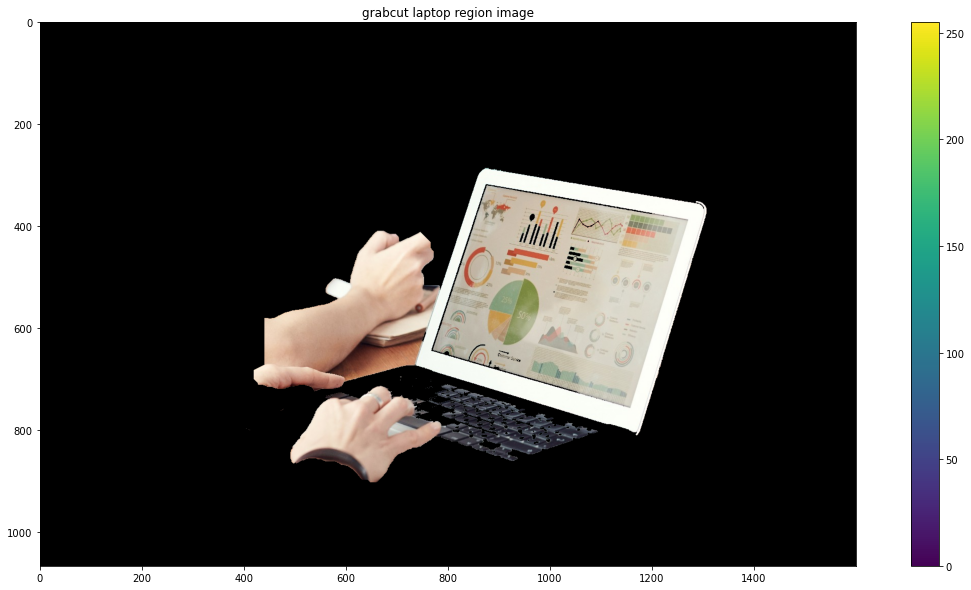

In [190]:
# grab cut foreground extraction
# original image
img_copy = img.copy()

# mask of original image set to 0 for background
mask = np.zeros(img.shape[:2],np.uint8)

# background model
bgdModel = np.zeros((1,65),np.float64)
# (1, 65) is the size of the temporary array needed by the algorithm

# foreground model
fgdModel = np.zeros((1,65),np.float64)

# define rectangle
rect = (400, 210, 920, 760)    # region in which the object is present

# apply grab cut
cv2.grabCut(img=img_copy, mask=mask, rect=rect, bgdModel=bgdModel, fgdModel=fgdModel,
            iterCount=5, mode=cv2.GC_INIT_WITH_RECT)

# mask 2: the pixels marked with 1, 3 are sure foreground
# other pixels marked with 0, 2 are sure background
mask2 = np.where((mask==2)|(mask==0), 0, 1).astype('uint8')

# new image
segmented_grabcut_image = img_copy * mask2[:,:,np.newaxis]

# display new image
plt.figure(figsize=(20, 10))
plt.imshow(convertToRGB(segmented_grabcut_image))
plt.title('grabcut laptop region image')
plt.colorbar()
plt.show()

### Extra: Corner Detection
---
- Corner detection is an approach used within computer vision systems to extract certain kinds of features and infer the contents of an image.
- Corner detection is frequently used in motion detection, image registration, video tracking, image mosaicing, panorama stitching, 3D modeling, and object recognition.

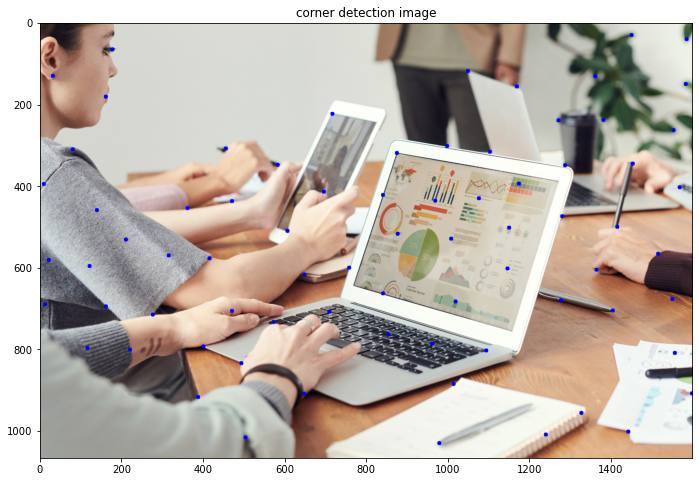

In [196]:
# corner detection
# original image
img_copy = img.copy()

# convert to grayscale
img_gray = cv2.cvtColor(img_copy, cv2.COLOR_BGR2GRAY)

# convert to float32
img_gray = np.float32(img_gray)

# apply corner detection
corners = cv2.goodFeaturesToTrack(image=img_gray, maxCorners=1000, qualityLevel=0.01, minDistance=100)
# maxCorners: maximum number of corners to return (upto 20000 corners) -> 0 - 20000   (default: 0)
# qualityLevel: parameter characterizing the minimal accepted quality of image corners (the minimum of the eigenvalues) -> 0.01 - 0.1   (default: 0.01)
# minDistance: minimum possible Euclidean distance between the returned corners

# convert corners to integers
corners = np.int0(corners)

# draw circles on detected corners
for corner in corners:
    x, y = corner.ravel()
    cv2.circle(img_copy, center=(x, y), radius=5, color=(255, 0, 0), thickness=-1)

# display image
plt.figure(figsize=(12, 8))
plt.imshow(convertToRGB(img_copy))
plt.title('corner detection image')
plt.show()

##### Observation:
- Detected corners properly for behind laptop image the coffee cup, book corners, etc.

### Extra: Feature Matching
---
- Feature matching is the process of finding corresponding features between different images.
- Feature matching is used in computer vision applications such as image registration, object detection, and object tracking.

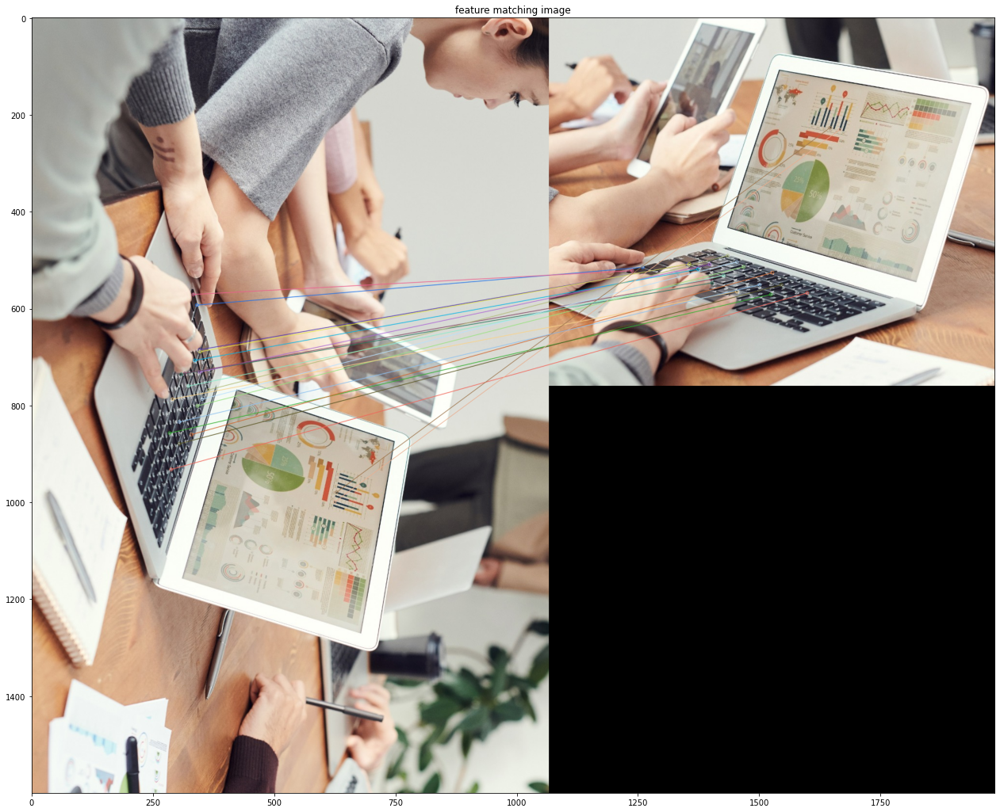

In [199]:
# feature matching
templ = cv2.imread('data_to_test/object_in_image.jpg', 1)

# create ORB detector
orb = cv2.ORB_create()

# find keypoints and descriptors
kp1, des1 = orb.detectAndCompute(img_rotated, None)
kp2, des2 = orb.detectAndCompute(templ, None)

# create matcher
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

# match descriptors
matches = bf.match(des1, des2)

# sort matches by distance
matches = sorted(matches, key=lambda x: x.distance)

# draw top matches
img_matches = cv2.drawMatches(img_rotated, kp1, templ, kp2, matches[:20], None, flags=2)
# matches[:20] -> top 20 matches
# flags=2 -> draw only the matches

# display image
plt.figure(figsize=(25, 18))
plt.imshow(convertToRGB(img_matches))
plt.title('feature matching image')
plt.show()

##### Observation:
- Detect objects on rotated image as well.